In [2]:
%matplotlib inline
import numpy as np
import pylab as plt
import os,sys,glob,natsort
import pandas as pd
import scipy.io
import ipywidgets 
import h5py
import scipy.stats
import pickle
import tqdm
def load_mat(data_path):
    f = h5py.File(data_path)
    obj = dict(h5py_obj=f)
    print("Loading Calculated Edge Data")
    obj['edges'] = np.array(f['edges'])
    print("Loading Raw Video Data [this takes some time...]")
    obj['data']  = np.array(f['data_prime'])
    aspect_ratio = obj['data'].shape[1:][::-1]
    obj['ar'] = np.array(aspect_ratio)
    return obj

def load_pickle(data_path):
    with open(data_path, 'rb') as fh:
        obj = pickle.load(fh)
    return obj  

In [3]:
base_dir      = '/data/sse/projects/Cambridge-IDE/dropbox'
base_mat_data_dir = f'{base_dir}/Matlab cleaned up movies + edges + data'
base_data_dir = f'{base_dir}/data'

state_info_path = f'{base_dir}/Regime diagrams 2013-2022.xlsx'

data_paths = natsort.realsorted(glob.glob(f'{base_data_dir}/theta*/*.pkl'))
print(f'Found {len(data_paths)} pickle files, showing first and last five: \n\n' + '\n'.join([*data_paths[:5],*data_paths[-5:]]))

Found 107 pickle files, showing first and last five: 

/data/sse/projects/Cambridge-IDE/dropbox/data/theta1degree/exp_w031.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta1degree/exp_w032.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta1degree/exp_w033.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta1degree/exp_w034.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta1degree/exp_w035.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta6degree/exp_w146.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta6degree/exp_w147.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta6degree/exp_w148.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta6degree/exp_w149.pkl
/data/sse/projects/Cambridge-IDE/dropbox/data/theta6degree/exp_w150.pkl


In [4]:
# Note, some information is lost with this excel file read due to how colors
# were used to emphasize relationships across multiple fields
df = pd.read_excel(state_info_path,skiprows=6)
# Show first five rows
df.head(5)

,Exp,Date,Who,θ (deg.),ρ_L,ρ_R,Δρ / ρ_0,Re^h,Regime classification on the day of the expt,Comments,...,Image quality of .dfi,Frame sep,Last frame (add 1 for total number of frame),Duration (s),T in A.T.U,dt in A.T.U.,dfm and mp4,dfi folder,mat and mp4,time series?
0,w001,2021-12-16,XJ GK,-1,1.082145,0.998754,0.080149,4720.825519,L,NaN,...,0: phantom lines,0.02,5991,119.84,950.449467,0.158646,1,0,0,NaN
1,w002,2021-12-16,XJ GK,0,1.080855,0.999035,0.078677,4677.295059,I,to be checked again,...,0: phantom lines,0.02,15561,311.24,2445.679008,0.157167,1,0,0,NaN
2,w003,2021-12-16,XJ GK,1,1.07324,1.007315,0.063373,4197.789743,I,NaN,...,0: phantom lines,0.02,13379,267.6,1887.191939,0.141056,1,0,0,NaN
3,w004,2021-12-16,XJ GK,2,1.066691,1.014635,0.050022,3729.499518,T,NaN,...,0: phantom lines,0.02,13271,265.44,1663.130032,0.125321,1,0,0,NaN
4,w005,2021-12-16,XJ GK,3,1.061912,1.020155,0.040111,3339.652147,T,to be checked again,...,0: phantom lines,0.02,37712,754.26,4231.862927,0.112215,1,0,0,NaN


# Select an Experiment to Visualize

Use the dropdown below to select an experiment to analyze!

In [5]:
data_paths_dropdown = ipywidgets.Dropdown(options=data_paths,value=data_paths[0],description="Analyze:")
data_paths_dropdown

Dropdown(description='Analyze:', options=('/data/sse/projects/Cambridge-IDE/dropbox/data/theta1degree/exp_w031…

In [137]:
data_path = data_paths_dropdown.value
experiment_id = xid = data_path.split('/')[-1].split('_')[1].split('.')[0]
time_between_frames = dt = float(df.set_index('Exp').loc[xid,'Frame sep'])

if time_between_frames != time_between_frames:
    print(f"\x1b[1;31mERROR -- time_between_frames (dt) is not a number!!!\x1b[0m")
print(df.set_index('Exp').loc[xid])
print(f"Selected data path: \x1b[1;32m\"{data_path}\"\x1b[0m\nSelected pickle file: \x1b[1;34m\"{data_path.split('/')[-1]}\"\x1b[0m")
print(f"\x1b[1;30mExperiment ID\x1b[1;0m: {xid}")
print(f"\x1b[1;30mComments\x1b[1;0m\n", df.set_index('Exp').loc[xid,'Comments'])
print(f"\x1b[1;30mFurther Comments\x1b[1;0m\n", df.set_index('Exp').loc[xid,'Further Comments '])
print(f"\x1b[1;30mTime between frames (dt)\x1b[1;0m: {dt} seconds")

Date                                            2022-02-17 00:00:00
Who                                                              GK
θ (deg.)                                                          4
ρ_L                                                         1.03821
ρ_R                                                        1.034299
Δρ / ρ_0                                                   0.003774
Re^h                                                    1024.361384
Regime classification on the day of the expt                      I
Comments                                                        NaN
Unnamed: 10                                                     NaN
Regime (by AL)                                                    I
Further Comments                                   Similar to above
Image quality of .dfi                                             2
Frame sep                                                      0.05
Last frame (add 1 for total number of frame)    

In [138]:
%%time
print("Loading data... [this takes ~30 seconds]")
obj = load_pickle(data_path)
LT,LZ,LX = obj['data'].shape
print(f"Number of timesteps: {LT}")
print(f"        pixel width: {LX}")
print(f"       pixel height: {LZ}")

Loading data... [this takes ~30 seconds]
Number of timesteps: 400
        pixel width: 3319
       pixel height: 466
CPU times: user 30.6 ms, sys: 2.02 s, total: 2.05 s
Wall time: 49.6 s


In [139]:
def interactive_plot(time_index):
    plt.figure(figsize=obj["ar"]/100)
    plt.imshow(obj["data"][time_index],cmap=plt.cm.Greys_r,origin='lower') # https://matplotlib.org/stable/tutorials/colors/colormaps.html
    plt.title(f"Experiment: {experiment_id}\nFlow at time index: {time_index} of {LT-1}",fontsize=24)
    plt.xlabel("Width",fontsize=20)
    plt.ylabel("Height",fontsize=20)
ipywidgets.interact(interactive_plot,time_index=ipywidgets.IntSlider(min=0, max=LT-1, step=1, value=np.random.randint(LT), description="Time Index:"))
None

interactive(children=(IntSlider(value=30, description='Time Index:', max=399), Output()), _dom_classes=('widge…

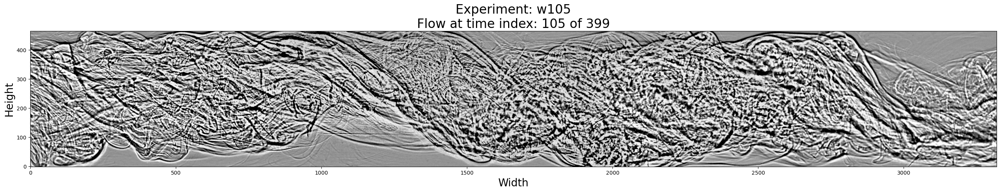

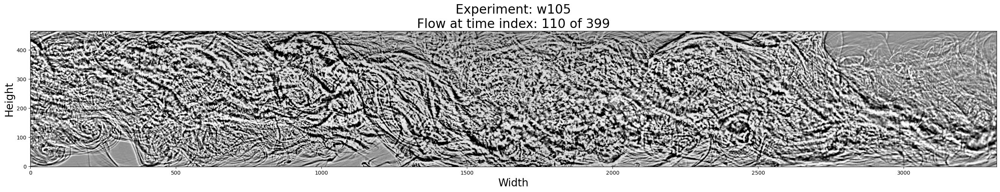

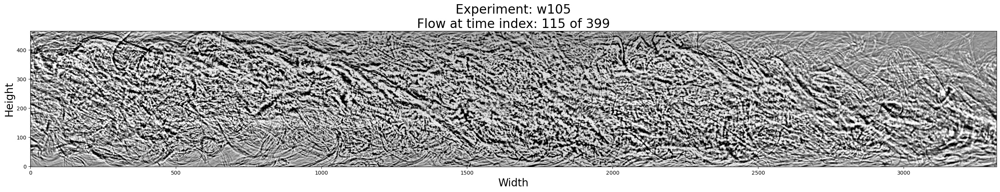

In [144]:
# Play around with the plotting of this one // start modifying from here
figd = f'figs/{experiment_id}'
os.makedirs(figd,exist_ok=True)

time_index = 105
plt.figure(figsize=obj["ar"]/100)
plt.imshow(obj["data"][time_index]/(2**16-1)*255.,cmap=plt.cm.Greys_r,origin='lower') # https://matplotlib.org/stable/tutorials/colors/colormaps.html
plt.title(f"Experiment: {experiment_id}\nFlow at time index: {time_index} of {LT-1}",fontsize=24)
plt.xlabel("Width",fontsize=20)
plt.ylabel("Height",fontsize=20)
plt.savefig(f'{figd}/t{time_index:04d}.png',bbox_inches='tight',dpi=100)
None
time_index = 110
plt.figure(figsize=obj["ar"]/100)
plt.imshow(obj["data"][time_index]/(2**16-1)*255.,cmap=plt.cm.Greys_r,origin='lower') # https://matplotlib.org/stable/tutorials/colors/colormaps.html
plt.title(f"Experiment: {experiment_id}\nFlow at time index: {time_index} of {LT-1}",fontsize=24)
plt.xlabel("Width",fontsize=20)
plt.ylabel("Height",fontsize=20)
plt.savefig(f'{figd}/t{time_index:04d}.png',bbox_inches='tight',dpi=100)
None
time_index = 115
plt.figure(figsize=obj["ar"]/100)
plt.imshow(obj["data"][time_index]/(2**16-1)*255.,cmap=plt.cm.Greys_r,origin='lower') # https://matplotlib.org/stable/tutorials/colors/colormaps.html
plt.title(f"Experiment: {experiment_id}\nFlow at time index: {time_index} of {LT-1}",fontsize=24)
plt.xlabel("Width",fontsize=20)
plt.ylabel("Height",fontsize=20)
plt.savefig(f'{figd}/t{time_index:04d}.png',bbox_inches='tight',dpi=100)
None

In [141]:
%%time
D=np.where((obj["data"]!=0)&(obj["data"]!=2**16-1),obj["data"],np.nan) #JB: why do we turn the != to nan and not the ==?
tN = 10*np.ceil(len(D)/10)
print('Computing standard deviations...')
masked_std = np.nanstd(np.nanstd(D,axis=-1),axis=-1)
raw_std    = obj['data'].std(axis=-1).std(axis=-1)
print('Computing means...')
masked_mean = np.nanmean(np.nanmean(D,axis=-1),axis=-1)
raw_mean    = obj['data'].mean(axis=-1).mean(axis=-1)
print('Computing skewnesses...')
masked_skew = scipy.stats.skew(scipy.stats.skew(D,axis=-1,bias=True,nan_policy='omit'),axis=-1,bias=True)
raw_skew = scipy.stats.skew(scipy.stats.skew(obj['data'],axis=-1,bias=True,nan_policy='omit'),axis=-1,bias=True)
print('Computing kurtosis...')
masked_kurt = scipy.stats.kurtosis(scipy.stats.kurtosis(D,axis=-1,bias=True,nan_policy='omit'),axis=-1,bias=True)
raw_kurt = scipy.stats.kurtosis(scipy.stats.kurtosis(obj['data'],axis=-1,bias=True,nan_policy='omit'),axis=-1,bias=True)

Computing standard deviations...
Computing means...
Computing skewnesses...
Computing kurtosis...
CPU times: user 1min 14s, sys: 24 s, total: 1min 38s
Wall time: 1min 39s


In [142]:
C = np.array([ np.histogram(d,bins=np.linspace(0,1,257)*2**16)[0] for d in D ])
dCdt = np.vstack([np.zeros((1,256)),np.diff(C,axis=0)])
d2Cdt2= np.vstack([np.zeros((1,256)),np.diff(dCdt,axis=0)])
T,B = np.meshgrid(np.arange(len(D)),np.arange(256),indexing='ij')

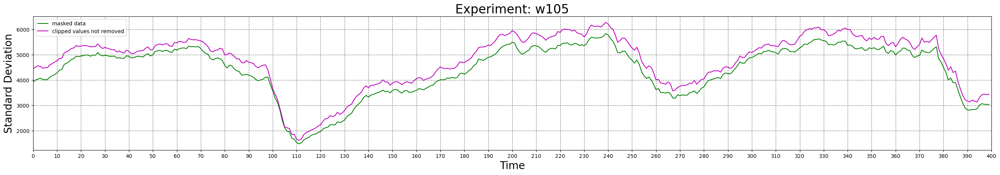

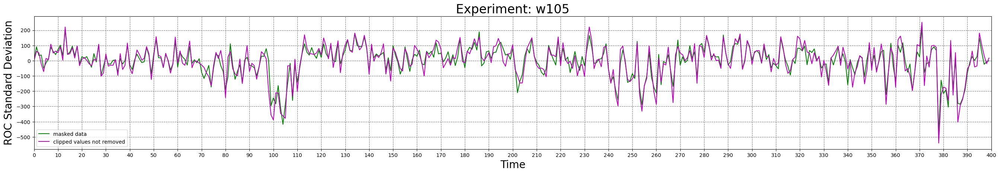

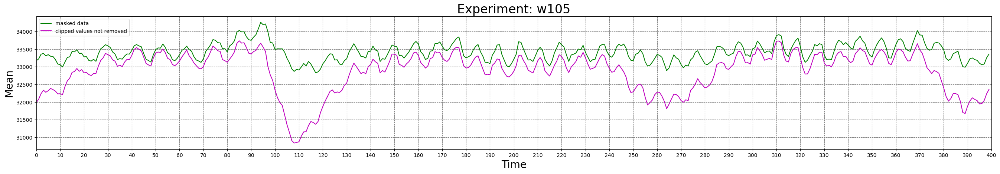

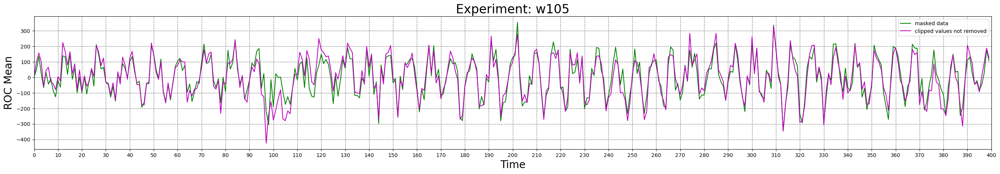

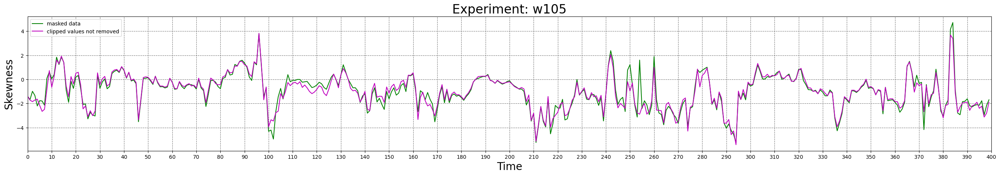

...

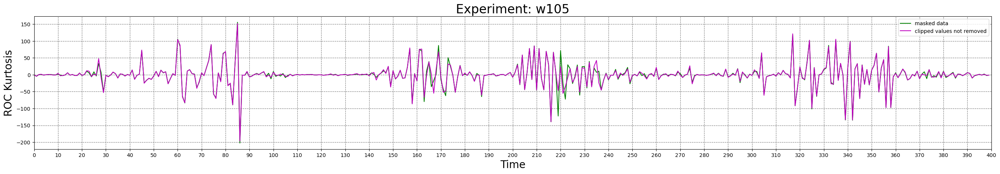

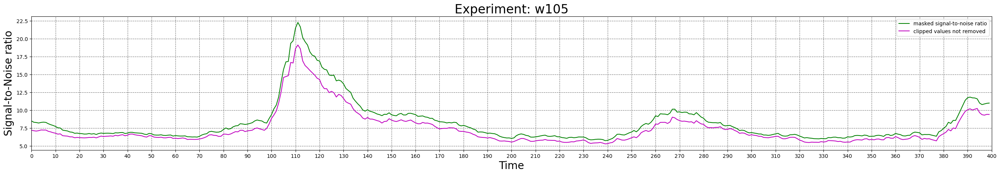

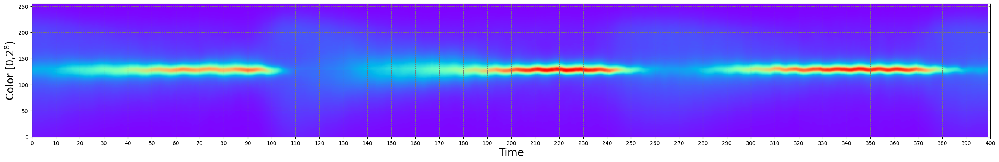

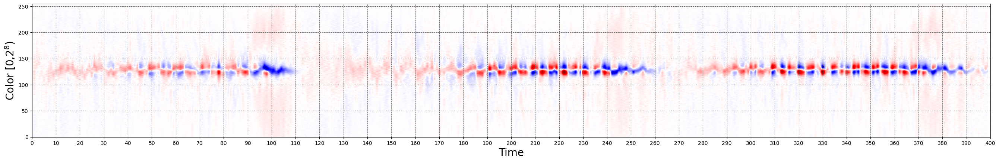

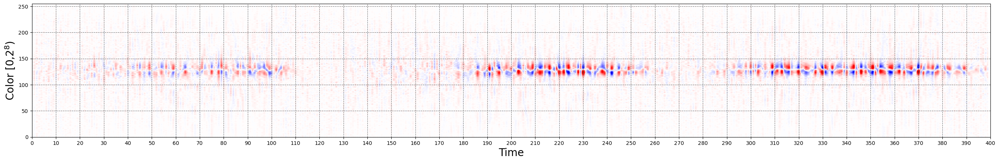

In [143]:
figd = f'figs/{experiment_id}'
os.makedirs(figd,exist_ok=True)

plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),masked_std,'g-',label='masked data')
plt.plot(np.arange(LT),   raw_std,'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Standard Deviation",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.legend()
plt.savefig(f'{figd}/SD.png',bbox_inches='tight',dpi=100)


plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),np.r_[0,np.diff(masked_std)],'g-',label='masked data')
plt.plot(np.arange(LT),np.r_[0,np.diff(   raw_std)],'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("ROC Standard Deviation",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.legend()

plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),masked_mean,'g-',label='masked data')
plt.plot(np.arange(LT),   raw_mean,'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Mean",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.savefig(f'{figd}/mean.png',bbox_inches='tight',dpi=100)
plt.legend()

plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),np.r_[0,np.diff(masked_mean)],'g-',label='masked data')
plt.plot(np.arange(LT),np.r_[0,np.diff(raw_mean)],'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("ROC Mean",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
#plt.savefig(f'{figd}/ROC_mean.png',bbox_inches='tight',dpi=100)
plt.legend()

plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),masked_skew,'g-',label='masked data')
plt.plot(np.arange(LT),   raw_skew,'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Skewness",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.legend()
plt.savefig(f'{figd}/skew.png',bbox_inches='tight',dpi=100)


plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),np.r_[0,np.diff(masked_skew)],'g-',label='masked data')
plt.plot(np.arange(LT),np.r_[0,np.diff(raw_skew)],'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("ROC Skewness",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
#plt.savefig(f'{figd}/ROC_skew.png',bbox_inches='tight',dpi=100)
plt.legend()

plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),masked_kurt,'g-',label='masked data')
plt.plot(np.arange(LT),   raw_kurt,'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Kurtosis",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.savefig(f'{figd}/kurtosis.png',bbox_inches='tight',dpi=100)
plt.legend()

plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),np.r_[0,np.diff(masked_kurt)],'g-',label='masked data')
plt.plot(np.arange(LT),np.r_[0,np.diff(raw_kurt)],'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("ROC Kurtosis",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
#plt.savefig(f'{figd}/ROC_kurtosis.png',bbox_inches='tight',dpi=100)
plt.legend()

plt.figure(figsize=obj["ar"]/100)
plt.plot(np.arange(LT),masked_mean/masked_std,'g-',label='masked signal-to-noise ratio')
plt.plot(np.arange(LT),   raw_mean/raw_std,'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Signal-to-Noise ratio",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.savefig(f'{figd}/SNR.png',bbox_inches='tight',dpi=100)
plt.legend()


plt.figure(figsize=obj["ar"]/100)
plt.contourf(T,B,C,levels=np.linspace(0,C.max(),257),cmap=plt.cm.rainbow)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Color [0,2$^{8}$)",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.savefig(f'{figd}/color_histogram.png',bbox_inches='tight',dpi=100)

plt.figure(figsize=obj["ar"]/100)
plt.contourf(T,B,dCdt,levels=np.linspace(-1,1,257)*dCdt.max(),cmap=plt.cm.seismic)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Color [0,2$^{8}$)",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.savefig(f'{figd}/color_dt_histogram.png',bbox_inches='tight',dpi=100)

plt.figure(figsize=obj["ar"]/100)
plt.contourf(T,B,d2Cdt2,levels=np.linspace(-1,1,257)*d2Cdt2.max(),cmap=plt.cm.seismic)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Color [0,2$^{8}$)",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.savefig(f'{figd}/color_d2t_histogram.png',bbox_inches='tight',dpi=100)


None

In [145]:
SG = obj['data'].astype(np.float32)#-2**15
dSGdz = SG[:,2:]-SG[:,:-2]
d2SGdz2 = SG[:,2:]-2*SG[:,1:-1]+SG[:,:-2]
dSGdx = SG[:,:,2:]-SG[:,:,:-2]
d2SGdx2 = SG[:,:,2:]-2*SG[:,:,1:-1]+SG[:,:,:-2]

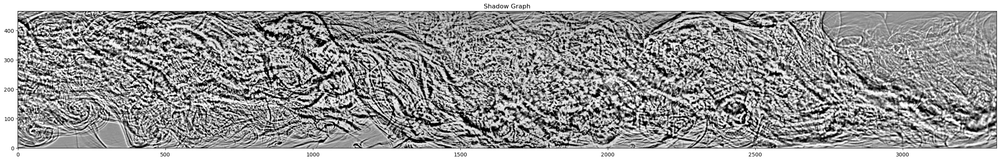

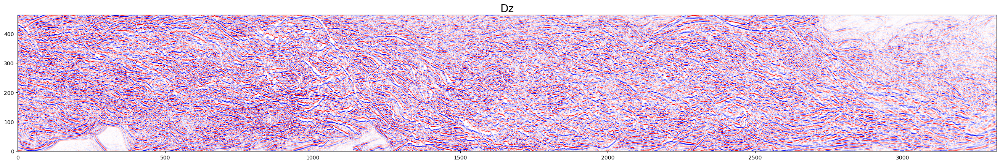

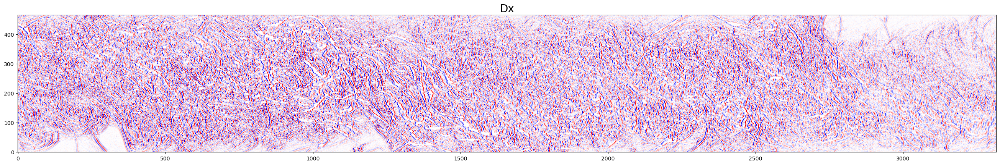

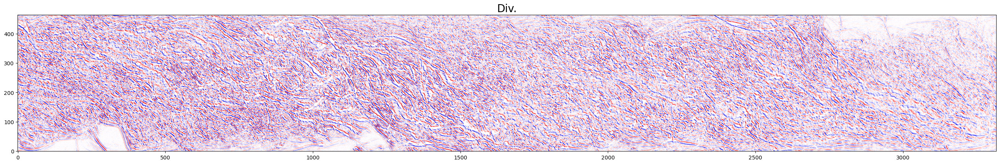

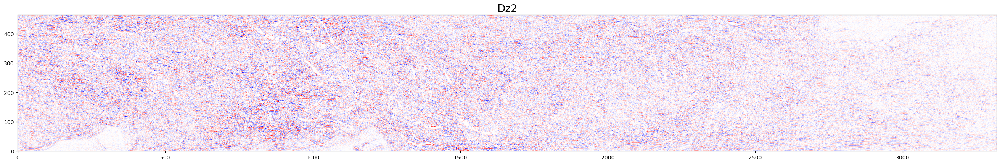

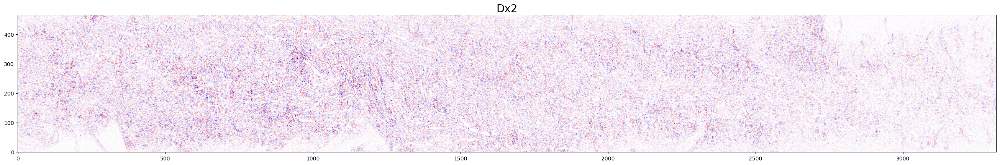

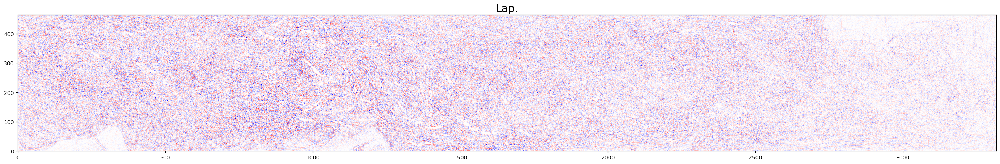

In [149]:
time_index = 110
_dz = dSGdz[time_index]
_dz2= d2SGdz2[time_index]
_dx = dSGdx[time_index]
_dx2= d2SGdx2[time_index]
_div = _dx[1:-1] + _dz[:,1:-1]
_lap = _dx2[1:-1] + _dz2[:,1:-1]
_dzM = np.abs(_dz).max()
_dz2M= np.abs(_dz2).max()
_divM= np.abs(_div).max()
_dxM = np.abs(_dx).max()
_dx2M= np.abs(_dx2).max()
_lapM= np.abs(_lap).max()
plt.figure(figsize=obj["ar"]/100)
plt.imshow(SG[time_index],cmap=plt.cm.Greys_r,origin='lower',vmin=0,vmax=2**16-1)
plt.title('Shadow Graph',fontsize=20)
set_opts=lambda x: dict(vmin=-x,vmax=x,origin='lower',cmap=plt.cm.seismic)
# first derivatives:
plt.figure(figsize=obj["ar"]/100)
plt.imshow(_dz,**set_opts(_dzM))
plt.title('Dz',fontsize=20)
plt.savefig(f'{figd}/dSGdz_t{time_index:04d}.png',bbox_inches='tight',dpi=100)

plt.figure(figsize=obj["ar"]/100)
plt.imshow(_dx,**set_opts(_dxM))
plt.title('Dx',fontsize=20)
plt.savefig(f'{figd}/dSGdx_t{time_index:04d}.png',bbox_inches='tight',dpi=100)

plt.figure(figsize=obj["ar"]/100)
plt.title('Div.',fontsize=20)
plt.imshow(_div,**set_opts(_divM))
plt.savefig(f'{figd}/div_t{time_index:04d}.png',bbox_inches='tight',dpi=100)

# second derivatives:
plt.figure(figsize=obj["ar"]/100)
plt.title('Dz2',fontsize=20)
plt.imshow(_dz2,**set_opts(_dz2M))

plt.figure(figsize=obj["ar"]/100)
plt.title('Dx2',fontsize=20)
plt.imshow(_dx2,**set_opts(_dx2M))

plt.figure(figsize=obj["ar"]/100)
plt.title('Lap.',fontsize=20)
plt.imshow(_lap,**set_opts(_lapM))

In [19]:
d2SGdx2[300].mean()

-0.02057645

In [147]:
L = np.linspace(-1,1,257)*np.abs(dSGdz).max()
Lz2 = np.linspace(-1,1,257)*np.abs(d2SGdz2).max()
Lx2 = np.linspace(-1,1,257)*np.abs(d2SGdz2).max()
CdSGdx,Cd2SGdx2,CdSGdz,Cd2SGdz2 = np.zeros((4,len(dSGdz),256))
for k in tqdm.tqdm(range(len(dSGdz))): 
    CdSGdz[k] = np.histogram(dSGdz[k],bins=L)[0]
    Cd2SGdz2[k] = np.histogram(d2SGdz2[k],bins=Lz2)[0]
    CdSGdx[k] = np.histogram(dSGdx[k],bins=L)[0]
    Cd2SGdx2[k] = np.histogram(d2SGdx2[k],bins=Lx2)[0]

100%|██████████| 400/400 [03:04<00:00,  2.17it/s]


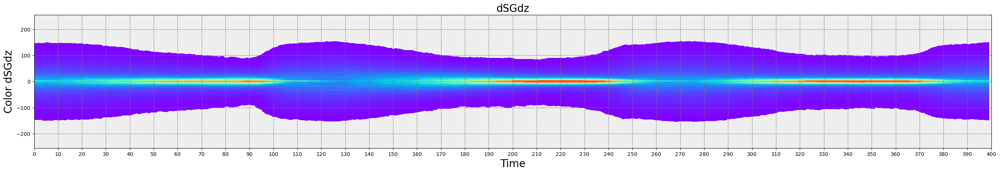

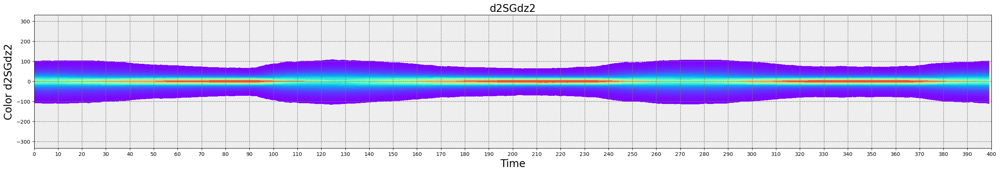

In [150]:
L1 = np.linspace(-1,1,256)*np.abs(dSGdz).max()/(2**16-1)*255
L2 = np.linspace(-1,1,256)*np.abs(d2SGdz2).max()/(2**16-1)*255
T1,B1 = np.meshgrid(np.arange(len(D)),L1,indexing='ij')
T2,B2 = np.meshgrid(np.arange(len(D)),L2,indexing='ij')
plt.figure(figsize=obj["ar"]/100)
plt.gca().set_facecolor('#eee')
plt.contourf(T1,B1,CdSGdz,levels=np.logspace(-2,0,21)*np.abs(CdSGdz).max(),cmap=plt.cm.rainbow)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Color dSGdz",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.title('dSGdz',fontsize=20)
plt.savefig(f'{figd}/color_histogram_dSGdz.png',bbox_inches='tight',dpi=100)

plt.figure(figsize=obj["ar"]/100)
plt.gca().set_facecolor('#eee')
plt.contourf(T2,B2,Cd2SGdz2,levels=np.logspace(-2,0,21)*np.abs(Cd2SGdz2).max(),cmap=plt.cm.rainbow)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Color d2SGdz2",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.title('d2SGdz2',fontsize=20)
plt.savefig(f'{figd}/color_histogram_d2SGdz2.png',bbox_inches='tight',dpi=100)

Generating poster images:
===

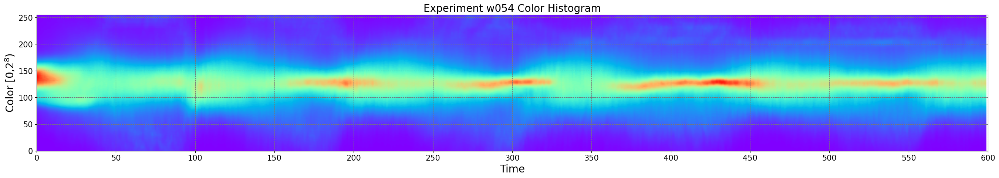

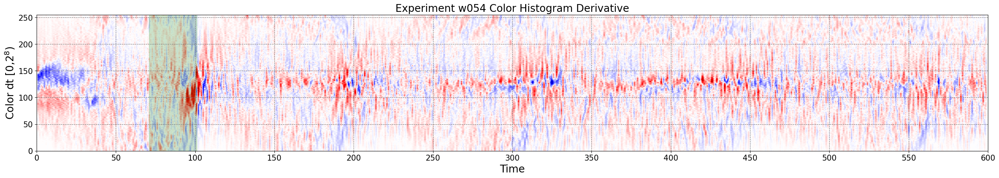

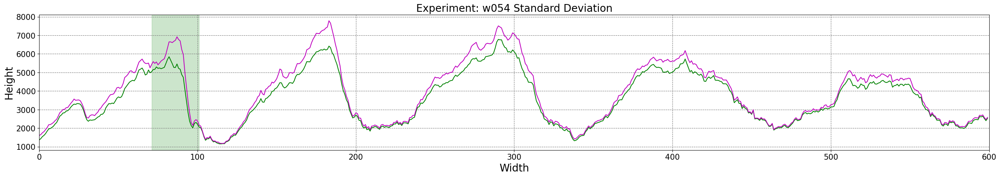

In [58]:
plt.figure(figsize=obj["ar"]/100)
plt.contourf(T,B,C,levels=np.linspace(0,C.max(),257),cmap=plt.cm.rainbow)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Color [0,2$^{8}$)",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::50],fontsize=15)
plt.yticks(fontsize=15)
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.title(f'Experiment {experiment_id} Color Histogram', fontsize=20)
plt.savefig(f'{figd}/poster_color_histogram.png',bbox_inches='tight',dpi=100)
None

plt.figure(figsize=obj["ar"]/100)
plt.contourf(T,B,dCdt,levels=np.linspace(-1,1,257)*dCdt.max(),cmap=plt.cm.seismic)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Color dt [0,2$^{8}$)",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::50],fontsize=15)
plt.yticks(fontsize=15)
plt.grid(linestyle='--',color='#777')
plt.xlim(0,tN)
plt.axvspan(71, 101, alpha=0.2, color="green")
plt.title(f'Experiment {experiment_id} Color Histogram Derivative',fontsize=20)
plt.savefig(f'{figd}/poster_color_dt_histogram.png',bbox_inches='tight',dpi=100)
None

plt.figure(figsize=obj["ar"]/100)
plt.xlim(0,tN)
plt.plot(np.arange(LT),masked_std,'g-',label='masked data')
plt.plot(np.arange(LT),   raw_std,'m-',label='clipped values not removed')
plt.title(f"Experiment: {experiment_id} Standard Deviation",fontsize=20)
plt.grid(linestyle='--',color='#777')
plt.xlabel("Width",fontsize=20)
plt.ylabel("Height",fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.axvspan(71, 101, alpha=0.2, color="green")
plt.savefig(f'{figd}/poster_SD.png',bbox_inches='tight',dpi=100)
None

In [ ]:
time_index = 40
plt.figure(figsize=obj["ar"]/100)
plt.hist(D[time_index].flatten(),bins=np.linspace(0,1,257)*2**16,fc='g')
plt.title(f"Experiment: {experiment_id} at time {time_index}",fontsize=24)
plt.xlabel("Color",fontsize=20)
plt.ylabel("Frequency",fontsize=20)
print(f'skew at t = {time_index}: ',scipy.stats.skew(D[time_index].flatten(), axis=0, bias=True, nan_policy='omit'))
print(f'kurtosis at t = {time_index}: ',scipy.stats.kurtosis(D[time_index].flatten(), axis=0, bias=True, nan_policy='omit'))
plt.savefig(f'{figd}/histogram_t{time_index:04d}.png',bbox_inches='tight',dpi=100)

In [ ]:
time_index = 250
plt.figure(figsize=obj["ar"]/100)
plt.hist(D[time_index].flatten(),bins=np.linspace(0,1,257)*2**16,fc='g')
plt.title(f"Experiment: {experiment_id} at time {time_index}",fontsize=24)
plt.xlabel("Color",fontsize=20)
plt.ylabel("Frequency",fontsize=20)
print(f'skew at t = {time_index}: ',scipy.stats.skew(D[time_index].flatten(), axis=0, bias=True, nan_policy='omit'))
print(f'kurtosis at t = {time_index}: ',scipy.stats.kurtosis(D[time_index].flatten(), axis=0, bias=True, nan_policy='omit'))
plt.savefig(f'{figd}/histogram_t{time_index:04d}.png',bbox_inches='tight',dpi=100)

In [ ]:
k = []
for x in range(LT-1):
    kurt = scipy.stats.kurtosis(D[x].flatten(), axis=-1, bias=True, nan_policy='omit')
    k.append(kurt)
    
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.figure(figsize=obj["ar"]/100)
plt.xlabel("Time",fontsize=20)
plt.ylabel("Kurtosis",fontsize=20)
plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
plt.plot(np.arange(LT),np.r_[0,k],'g-',label='kurtosis')
plt.grid(linestyle='--',color='#777')
plt.savefig(f'{figd}/kurtosis.png',bbox_inches='tight',dpi=100)
None
# plt.figure(figsize=obj["ar"]/100)
# plt.xlabel("Time",fontsize=20)
# plt.ylabel("ROC Kurtosis",fontsize=20)
# plt.xticks(np.linspace(0,len(D),len(D)+1)[::10])
# plt.plot(np.arange(LT),np.r_[0,np.diff(k)],'g-',label='kurtosis')
# plt.grid(linestyle='--',color='#777')
# plt.savefig(f'{figd}/kurtosis.png',bbox_inches='tight',dpi=100)

In [ ]:
d=obj["data"][60]

In [ ]:
nd = np.where((d!=0)&(d!=2**16-1),d,np.nan)

In [ ]:
# Play around with the plotting of this one // start modifying from here
time_index = 200
plt.figure(figsize=obj["ar"]/100)
plt.gca().set_facecolor('r')

plt.imshow(nd,cmap=plt.cm.Greys) # https://matplotlib.org/stable/tutorials/colors/colormaps.html
plt.title(f"Experiment: {experiment_id}\nFlow at time index: {time_index} of {LT-1}",fontsize=24)
plt.xlabel("Width",fontsize=20)
plt.ylabel("Height",fontsize=20)
None

In [ ]:
plt.figure(figsize=obj["ar"]/100)
plt.hist(nd.flatten(),bins=np.linspace(0,1,1001)*2**16,fc='g')
plt.title(f"Experiment: {experiment_id}",fontsize=24)
plt.xlabel("Color",fontsize=20)
plt.ylabel("Frequency",fontsize=20)

In [ ]:
T,B = np.meshgrid(np.arange(len(D)),np.linspace(0,1,257),indexing='ij')
T.shape

In [ ]:
# experimental defect in 68